In [1]:
%load_ext autoreload
%autoreload 2

from nca.models import BaselineNCA, FCInvAE
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from kornia import augmentation

from tqdm.auto import tqdm
import base64
import matplotlib
from io import BytesIO
from PIL import Image
from IPython.display import HTML

In [2]:
def make_gif(nca_out, fps=10):
    seq_out = nca_out.detach().cpu().numpy()
    pil_arrs = (plt.cm.viridis(seq_out)[:,:,:,:3] * 255).astype(np.uint8)
    pils = [Image.fromarray(arr).resize((500, 500), Image.NEAREST) for arr in pil_arrs]
    
    fp = BytesIO()
    pils[0].save(
        fp,
        format="gif",
        save_all=True,
        append_images=pils[1:],
        duration=1000 / fps,
        loop=0,
    )
    fp.seek(0)
    
    b64 = base64.b64encode(fp.read()).decode("ascii")
    html = f"""<img src="data:image/gif;base64,{b64}" />"""
    return HTML(html)

In [3]:
device = "cuda"

In [4]:
sampled_nca = BaselineNCA(zero_w2=False).to(device)

In [5]:
S, s = 64, 32
image_rep = torch.zeros(1, 4, S, S).to(device)
torch.nn.init.normal_(image_rep[:, :, S // 2 - s // 2:S // 2 + s // 2, S // 2 - s // 2:S // 2 + s // 2])
b, c, h, w = image_rep.shape

nca_out = sampled_nca.forward_many(image_rep, steps=200)
nca_out = torch.stack(nca_out)

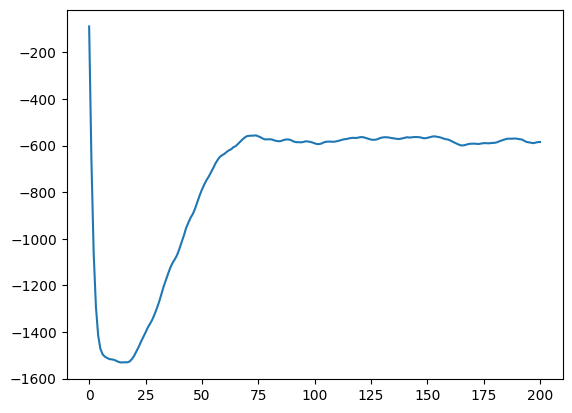

In [6]:
vs = nca_out.reshape(nca_out.shape[0], -1).sum(axis=1).detach().cpu()
plt.plot(vs)

In [7]:
nca_out[0].sum(), nca_out[1].sum(), nca_out[5].sum(), nca_out[30].sum()

(tensor(-88.6637, device='cuda:0', grad_fn=<SumBackward0>),
 tensor(-657.2651, device='cuda:0', grad_fn=<SumBackward0>),
 tensor(-1472.7018, device='cuda:0', grad_fn=<SumBackward0>),
 tensor(-1299.2883, device='cuda:0', grad_fn=<SumBackward0>))


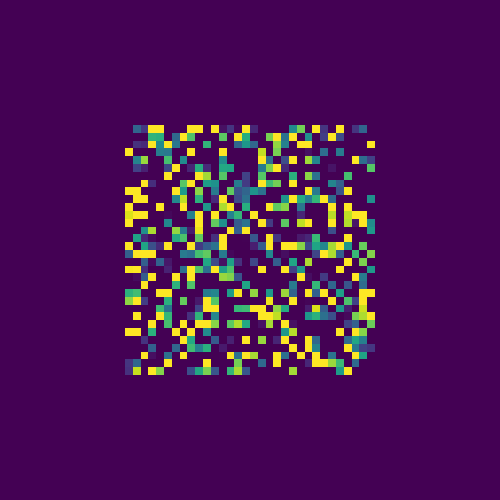

In [8]:
make_gif(nca_out[:,0,0], fps=10)

In [61]:
noise_size = 1
noiser = nn.Sequential(
    augmentation.RandomAffine(
        degrees=30,
        translate=[0.1, 0.1],
        scale=[0.9, 1.1],
        shear=[-10, 10],
    ),
    augmentation.RandomPerspective(0.6, p=0.5),
    augmentation.RandomBoxBlur(kernel_size=(5, 5), p=noise_size),
    augmentation.RandomErasing((0.1, 0.2), (0.3, 1 / 0.3), p=noise_size),
    # augmentation.RandomJigsaw(grid=(4, 4) ,p=noise_size),
    augmentation.RandomGaussianNoise(0, 1, same_on_batch=False, p=noise_size),
)

In [62]:
from copy import deepcopy

In [ ]:
# inv_ae = FCInvAE(msg_size=8, frame_size=128).to(device)
# nca = deepcopy(sampled_nca)
lr = 0.001
optim = torch.optim.Adam(list(nca.parameters()) + list(inv_ae.parameters()), lr=lr)
history = []

bs = 100
steps = 30
its = 1000

pbar = tqdm(range(its))
for e in pbar:
    msg = inv_ae.sample_msg(bs)
    image = inv_ae.encode(msg)
    image_rep = image.repeat(1, 4, 1, 1)
    nca_out = nca.forward_many(image_rep, steps=steps)
    nca_out = torch.stack(nca_out)

    last_frame = nca_out[-1]
    last_frame = noiser(last_frame)[:,0]
    decode_inp = last_frame.reshape(bs, -1)
    decoded_msg = inv_ae.decode(decode_inp)

    loss = F.mse_loss(decoded_msg, msg)

    optim.zero_grad()
    loss.backward()
    optim.step()

    pbar.set_description(f"Loss: {loss.item():0.6f}")
    history.append(loss.item())

  0%|          | 0/1000 [00:00<?, ?it/s]

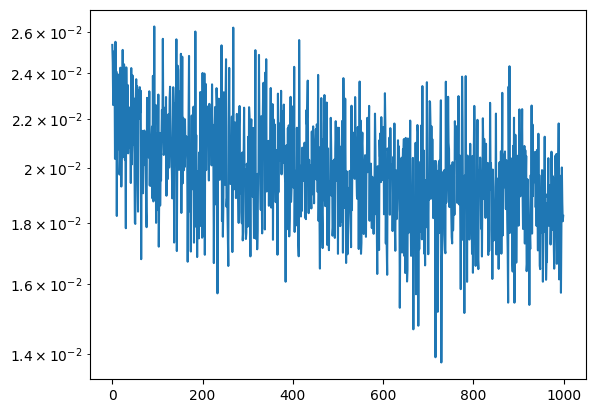

In [55]:
plt.plot(history)
plt.yscale('log')

In [56]:
out = nca_out[:,0,0].detach().cpu()
out.shape

torch.Size([31, 128, 128])

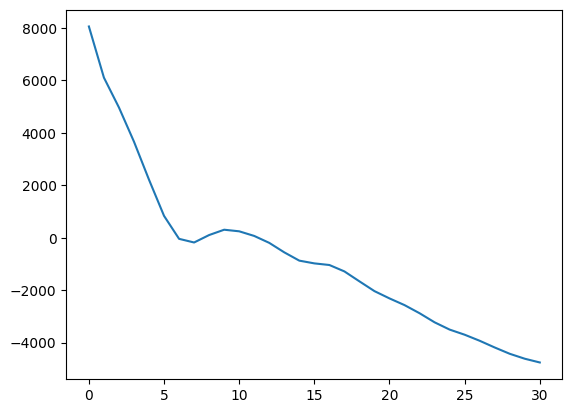

In [57]:
plt.plot(out.reshape(out.shape[0], -1).sum(axis=1))

In [58]:
# plt.imshow(out[20])

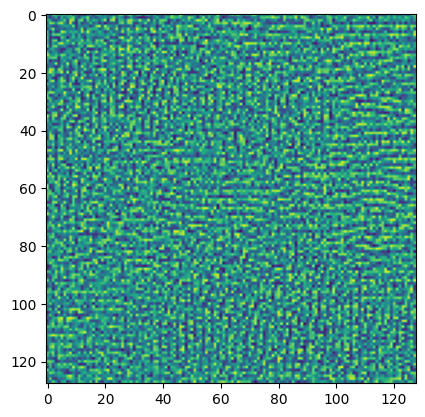

In [59]:
plt.imshow(image[3, 0].detach().cpu())


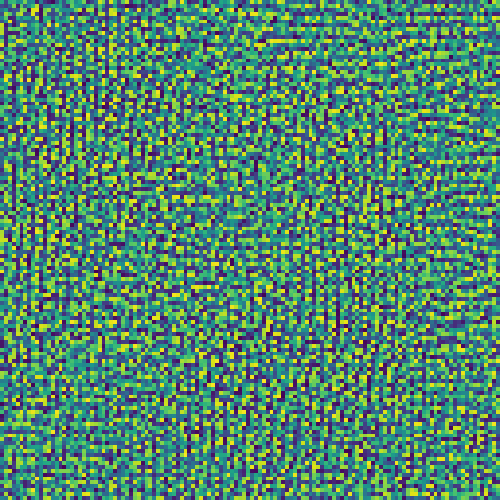

In [60]:
make_gif(nca_out[:,0,0], fps=10)

In [17]:
msg = inv_ae.sample_msg(bs)
image = inv_ae.encode(msg)
image_rep = image.repeat(1, 4, 1, 1)
nca_out = nca.forward_many(image_rep, steps=steps)
nca_out = torch.stack(nca_out)

In [18]:
S, s = 64, 32
image_rep = torch.zeros(1, 4, S, S).to(device)
torch.nn.init.normal_(image_rep[:, :, S // 2 - s // 2:S // 2 + s // 2, S // 2 - s // 2:S // 2 + s // 2])
b, c, h, w = image_rep.shape

nca_out = sampled_nca.forward_many(image_rep, steps=200)
nca_out = torch.stack(nca_out)

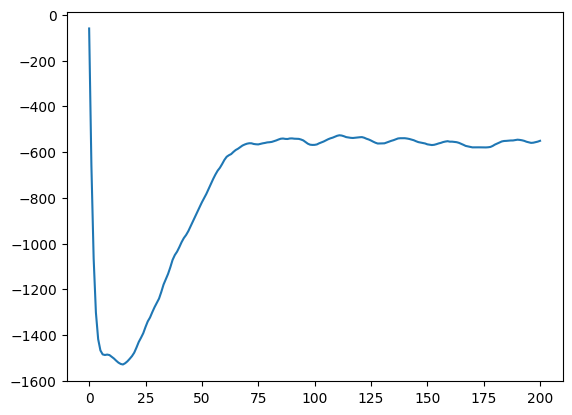

In [19]:
vs = nca_out.reshape(nca_out.shape[0], -1).sum(axis=1).detach().cpu()
plt.plot(vs)


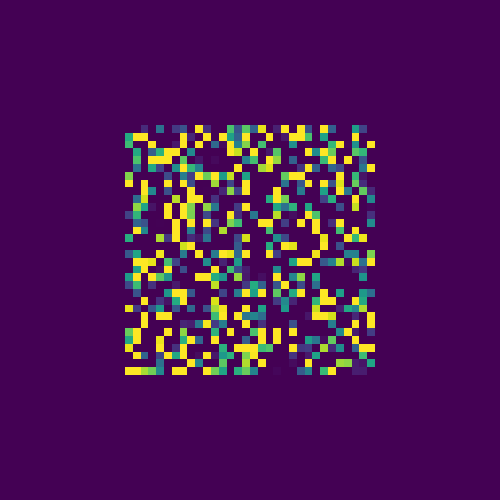

In [20]:
make_gif(nca_out[:,0,0], fps=10)